In [1]:
import librosa
import librosa.display
import matplotlib.pyplot as plt 

In [5]:
!pip install matplotlib

  Using cached cycler-0.12.1-py3-none-any.whl (8.3 kB)
  Using cached pyparsing-3.1.2-py3-none-any.whl (103 kB)


In [3]:
!pip install librosa

  Using cached librosa-0.10.2.post1-py3-none-any.whl (260 kB)
  Using cached scikit_learn-1.4.2-cp39-cp39-win_amd64.whl (10.6 MB)
  Using cached lazy_loader-0.4-py3-none-any.whl (12 kB)
  Using cached pooch-1.8.1-py3-none-any.whl (62 kB)
  Using cached audioread-3.0.1-py3-none-any.whl (23 kB)
  Using cached soundfile-0.12.1-py2.py3-none-win_amd64.whl (1.0 MB)
  Using cached joblib-1.4.2-py3-none-any.whl (301 kB)
  Using cached threadpoolctl-3.5.0-py3-none-any.whl (18 kB)


## Loading audio file

In [2]:
audio_path = 'Fifa-vocal-noise-rem-only.wav'
scale, sampling_rate = librosa.load(audio_path)

## Extracting Mel spectrogram

In [3]:
mel_spectrogram = librosa.feature.melspectrogram(y=scale, sr=sampling_rate, n_fft=2048, hop_length=512, n_mels=10)

In [4]:
mel_spectrogram.shape

(10, 65066)

In [5]:
def display(mel_spectrogram):
    plt.figure(figsize=(25, 10))
    librosa.display.specshow(mel_spectrogram,
                            x_axis='time',
                            y_axis='mel',
                            sr=sampling_rate)
    plt.show()
    

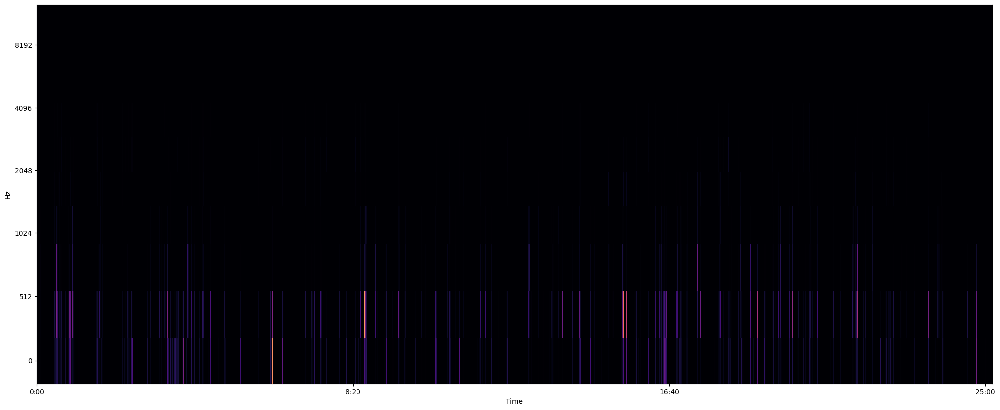

In [6]:
display(mel_spectrogram=mel_spectrogram)

In [7]:
log_mel_spectogram = librosa.power_to_db(mel_spectrogram)

In [8]:
log_mel_spectogram.shape

(10, 65066)

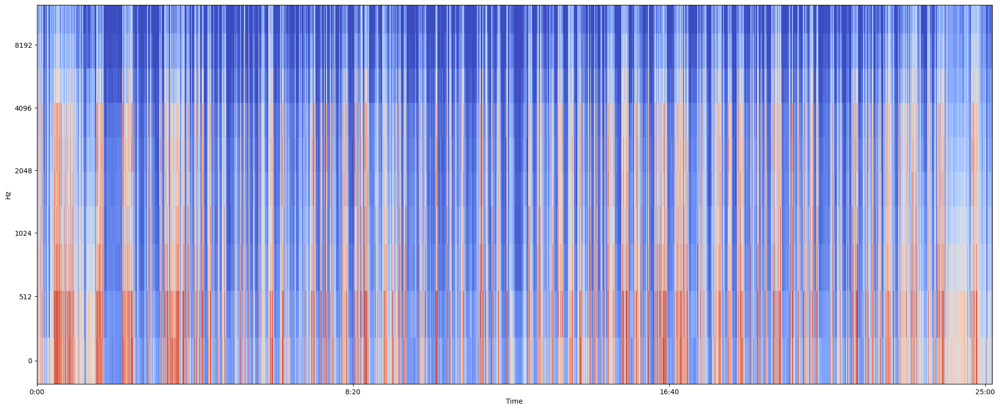

In [9]:
display(log_mel_spectogram)

## Mel spectrogram for each segment

### Calculate the total number of intervals

In [10]:
interval_length = 10
total_duration = len(scale) / sampling_rate
num_intervals = int(total_duration // interval_length)

In [11]:
total_duration

1510.8266666666666

In [12]:
num_intervals

151

### Calculate the Mel spectrogram for each interval

In [13]:
mel_spectrograms = list()
for interval in range(num_intervals):
    # Define the start and end index for the current interval
    start_index = interval * interval_length * sampling_rate
    end_index = (interval + 1) * interval_length * sampling_rate

    # Get the audio slice for the current interval
    interval_audio = scale[start_index:end_index]

    # Obtain the Mel spectrogram for the interval
    interval_mel_spec = librosa.feature.melspectrogram(y=interval_audio, sr=sampling_rate, n_fft=2048, hop_length=512, n_mels=10)

    interval_log_mel_spec = librosa.power_to_db(interval_mel_spec)

    # Append the Mel spectrogram to the list
    mel_spectrograms.append(interval_log_mel_spec)

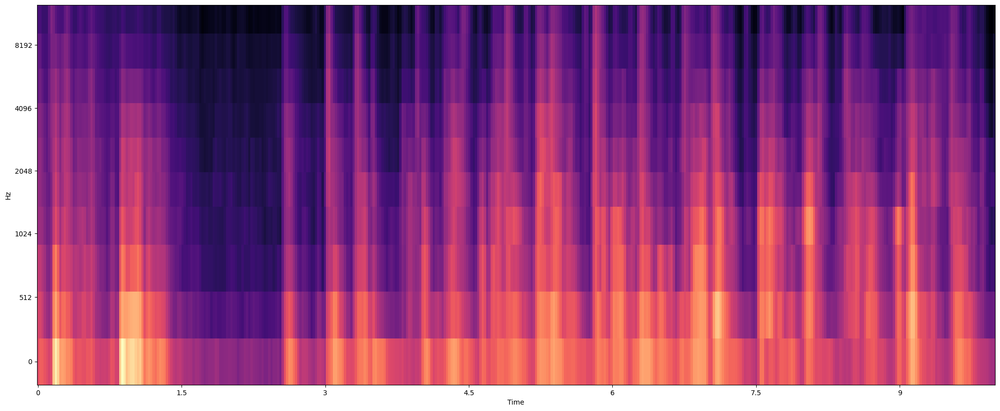

In [14]:
display(mel_spectrograms[150])

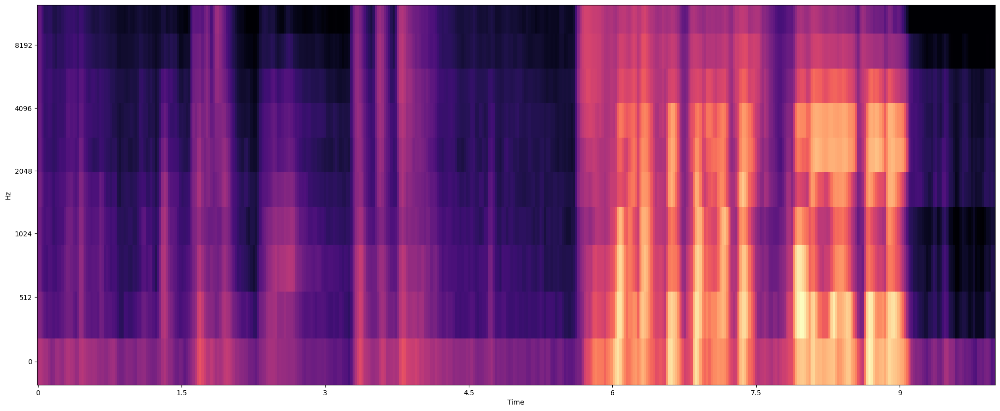

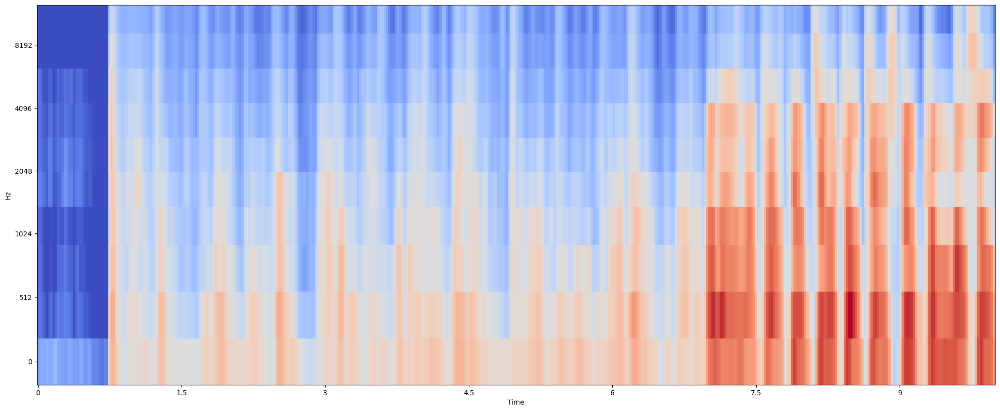

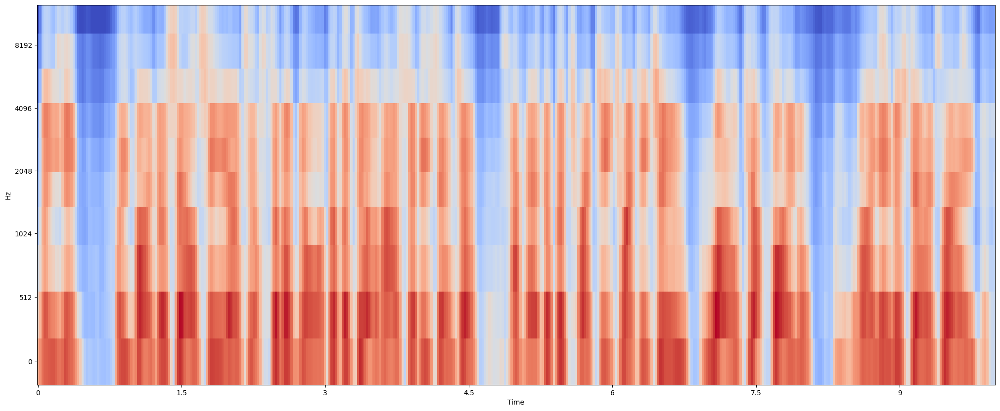

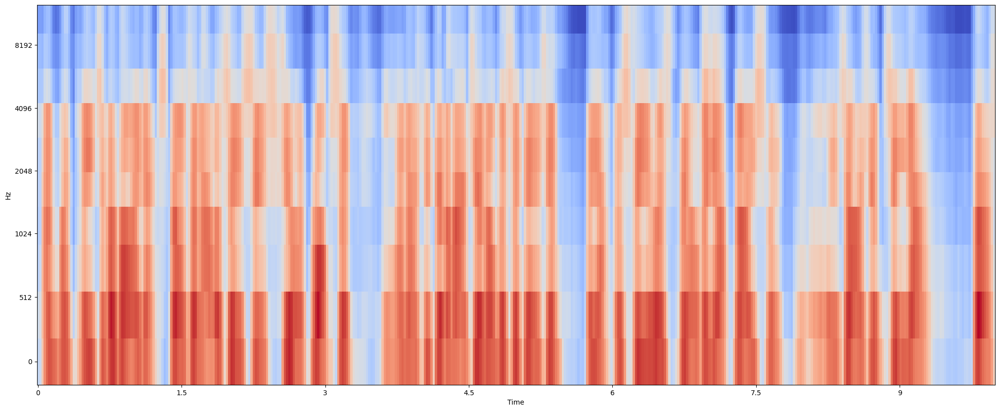

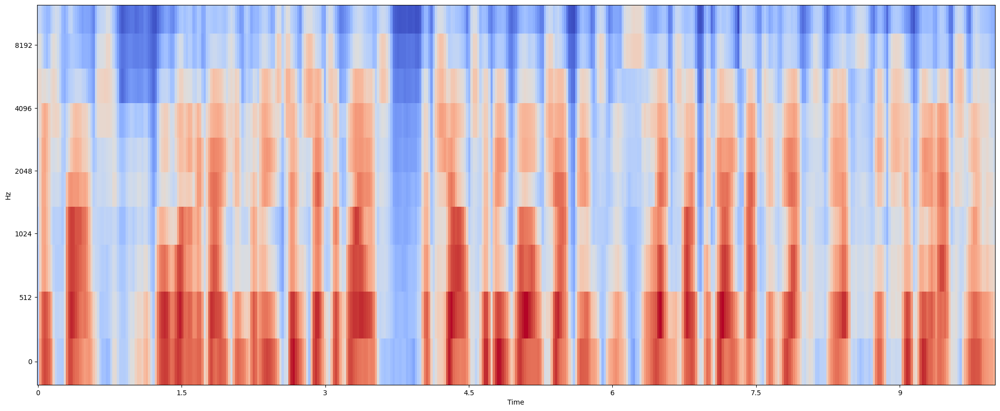

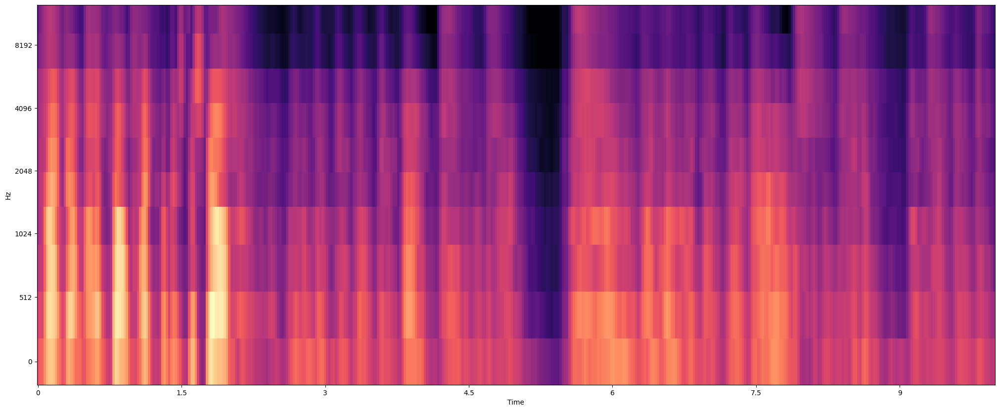

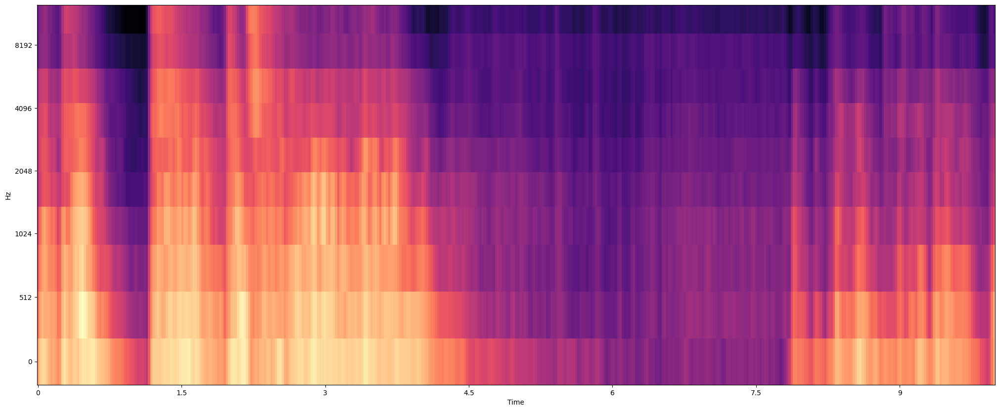

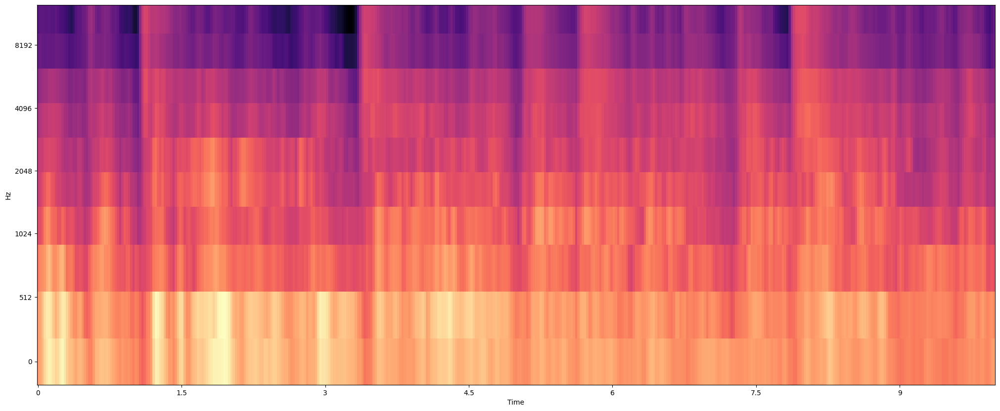

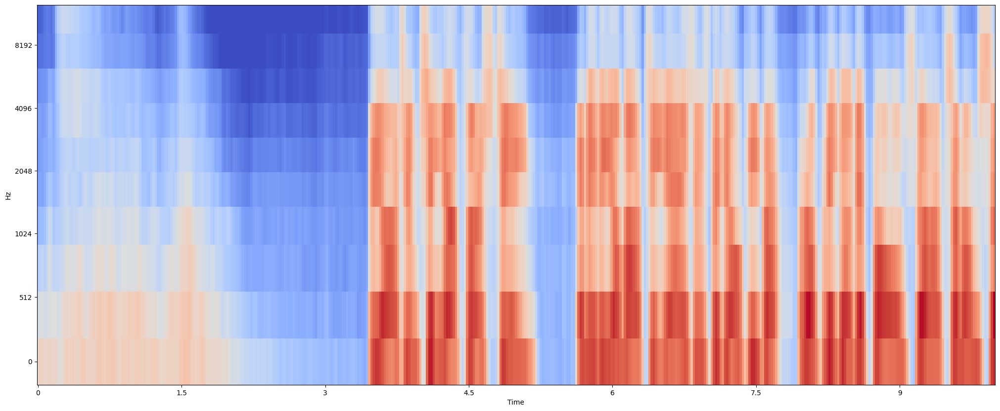

In [15]:
for i in range(1,len(mel_spectrogram)):
    display(mel_spectrograms[i])

C:\Users\Keerthana\AppData\Local\Temp\ipykernel_34532\1038244109.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(10, 4))


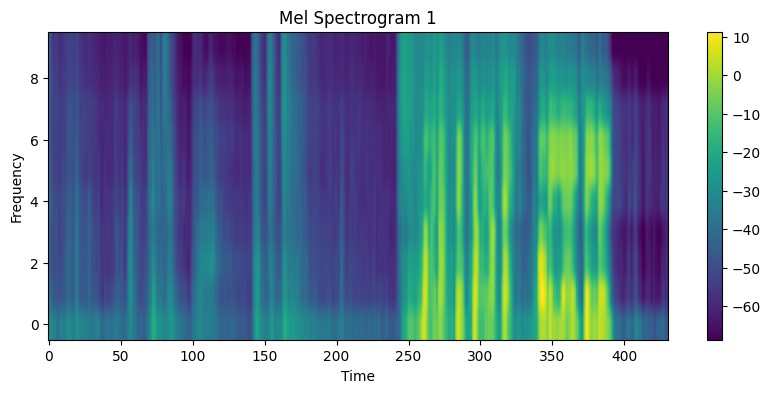

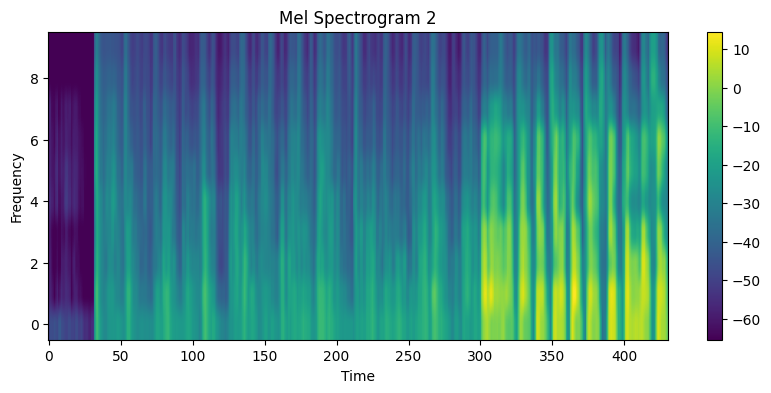

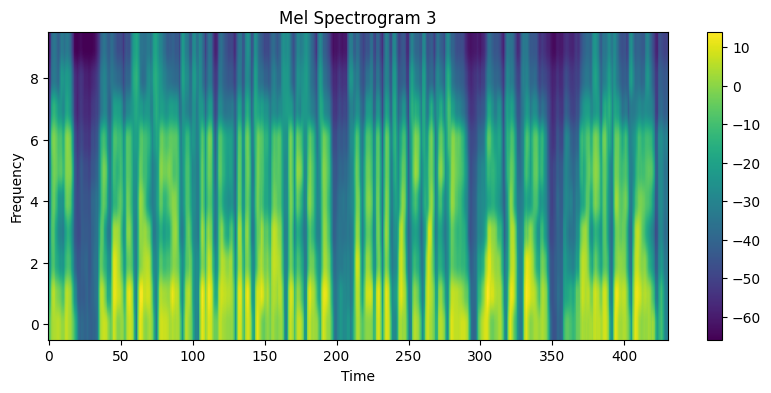

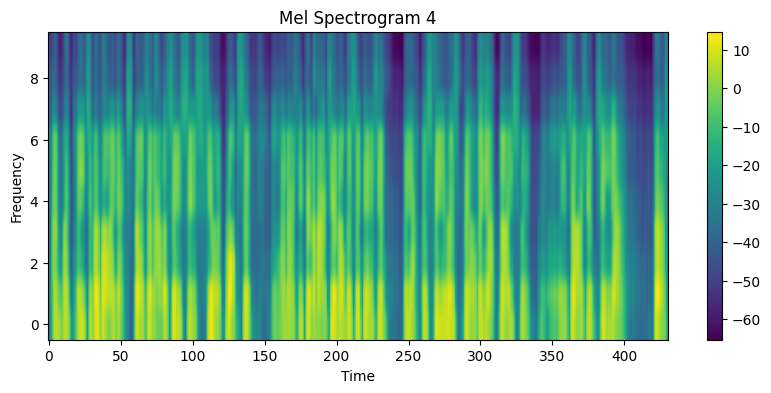

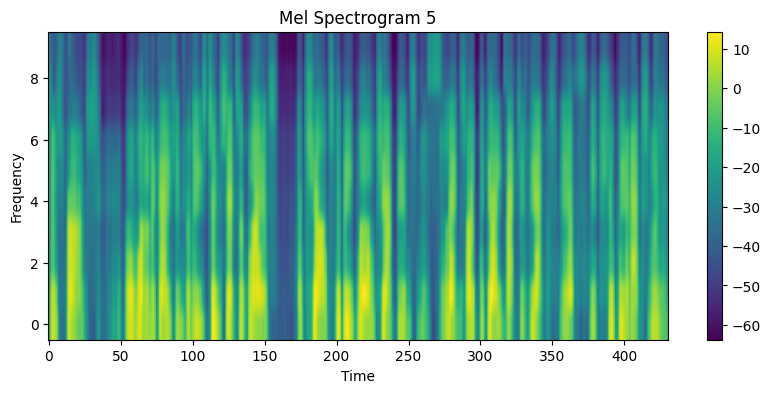

...

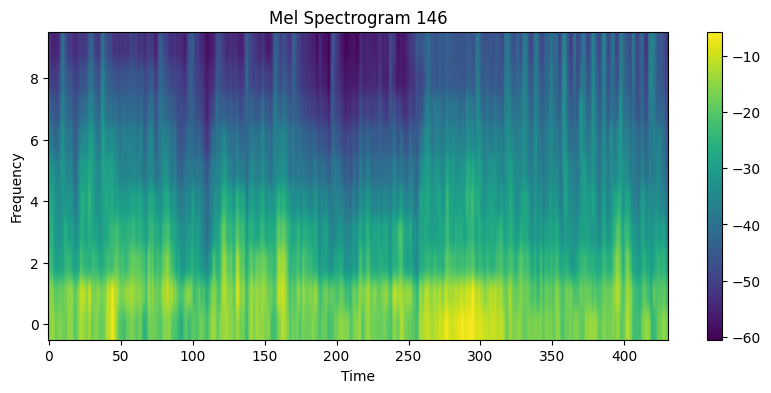

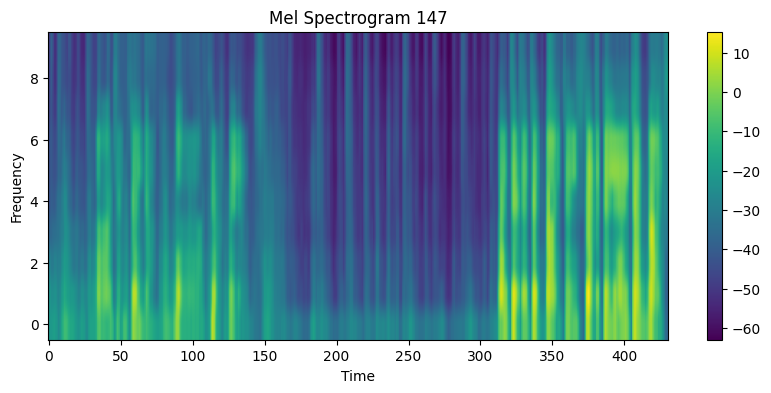

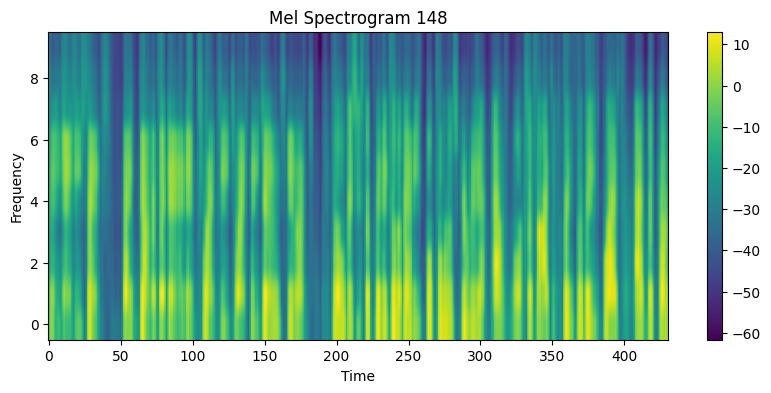

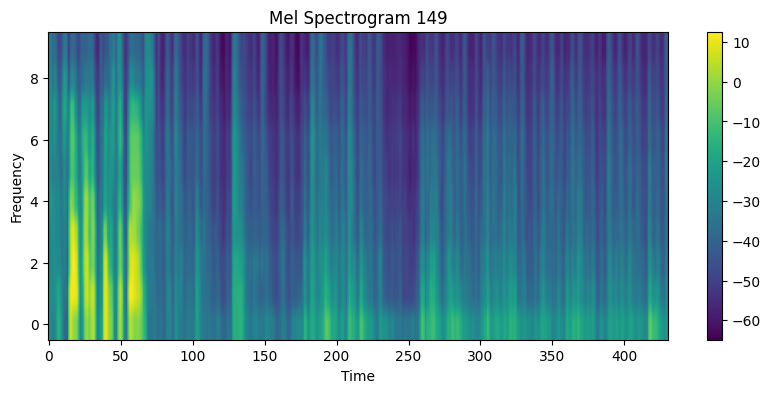

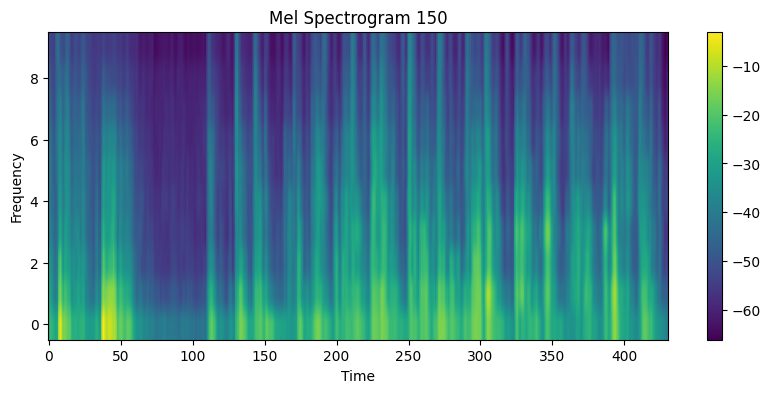

In [16]:
for i in range(1, len(mel_spectrograms)):
    plt.figure(figsize=(10, 4))
    plt.imshow(mel_spectrograms[i], aspect='auto', origin='lower')
    plt.colorbar()
    plt.title(f'Mel Spectrogram {i}')
    plt.xlabel('Time')
    plt.ylabel('Frequency')


In [ ]:
import os
import matplotlib.pyplot as plt
import numpy as np

# Example mel_spectrogram data
# Replace this with your actual mel_spectrogram data

# Directory to save the images
save_directory = 'mel_spectrogram_images_1'

# Create directory if it doesn't exist
if not os.path.exists(save_directory):
    os.makedirs(save_directory)

# Loop through each mel spectrogram and save as an image
for i in range(1, len(mel_spectrograms)):
    plt.figure(figsize=(10, 4))
    plt.imshow(mel_spectrograms[i], aspect='auto', origin='lower')
    plt.colorbar(format='%+2.0f dB')
    plt.title(f'Mel Spectrogram {i}')
    plt.xlabel('Time')
    plt.ylabel('Frequency')

    # Save the figure
    file_path = os.path.join(save_directory, f'mel_spectrogram_{i}.png')
    plt.savefig(file_path)
    plt.close()  # Close the figure to save memory

    print(f'Saved {file_path}')


In [18]:
import os
import matplotlib.pyplot as plt
import numpy as np

# Example mel_spectrogram data
# Replace this with your actual mel_spectrogram data



# Directory to save the images
save_directory = 'mel_spectrogram_images'

# Create directory if it doesn't exist
if not os.path.exists(save_directory):
    os.makedirs(save_directory)

# Loop through each mel spectrogram and save as an image
for i in range(0, len(mel_spectrograms)):

    plt.imshow(mel_spectrograms[i], aspect='auto', origin='lower', cmap='viridis')  # Change the colormap here
   

    # Save the figure
    file_path = os.path.join(save_directory, f'mel_spectrogram_{i}.png')
    plt.savefig(file_path)
    plt.close()  # Close the figure to save memory

    print(f'Saved {file_path}')


Saved mel_spectrogram_images\mel_spectrogram_0.png
Saved mel_spectrogram_images\mel_spectrogram_1.png
Saved mel_spectrogram_images\mel_spectrogram_2.png
Saved mel_spectrogram_images\mel_spectrogram_3.png
Saved mel_spectrogram_images\mel_spectrogram_4.png
Saved mel_spectrogram_images\mel_spectrogram_5.png
Saved mel_spectrogram_images\mel_spectrogram_6.png
Saved mel_spectrogram_images\mel_spectrogram_7.png
Saved mel_spectrogram_images\mel_spectrogram_8.png
Saved mel_spectrogram_images\mel_spectrogram_9.png
Saved mel_spectrogram_images\mel_spectrogram_10.png
Saved mel_spectrogram_images\mel_spectrogram_11.png
Saved mel_spectrogram_images\mel_spectrogram_12.png
Saved mel_spectrogram_images\mel_spectrogram_13.png
Saved mel_spectrogram_images\mel_spectrogram_14.png
Saved mel_spectrogram_images\mel_spectrogram_15.png
Saved mel_spectrogram_images\mel_spectrogram_16.png
Saved mel_spectrogram_images\mel_spectrogram_17.png
Saved mel_spectrogram_images\mel_spectrogram_18.png
Saved mel_spectrogram_

In [76]:
save_directory

'mel_spectrogram_images_1'

In [75]:
file_path

'mel_spectrogram_images_1\\mel_spectrogram_51.png'

In [79]:
!pip install tensorflow